In [ ]:
!pip install ultralytics
from ultralytics import YOLO
model = YOLO("yolo11s.pt")

In [2]:
import yaml
with open(r'C:\Users\Windows\Desktop\selva postulate\Mine\road sign\dataset.yaml') as f:
    data=yaml.safe_load(f)

In [3]:
data

{'train': '../train/images',
 'val': '../val/images',
 'test': '../test/images',
 'nc': 9,
 'names': {0: 'Trafic Light Signal',
  1: 'Stop Signal',
  2: 'Speedlimit Signal',
  3: 'Crosswalk Signal',
  4: 'Crosswalk',
  5: 'Pedestrian',
  6: 'Bus',
  7: 'Car',
  8: 'Truck'}}

In [4]:
class_names=['Stop Signal','Speedlimit Signal','Crosswalk Signal','Crosswalk','Pedestrian','Bus','Car','Truck']

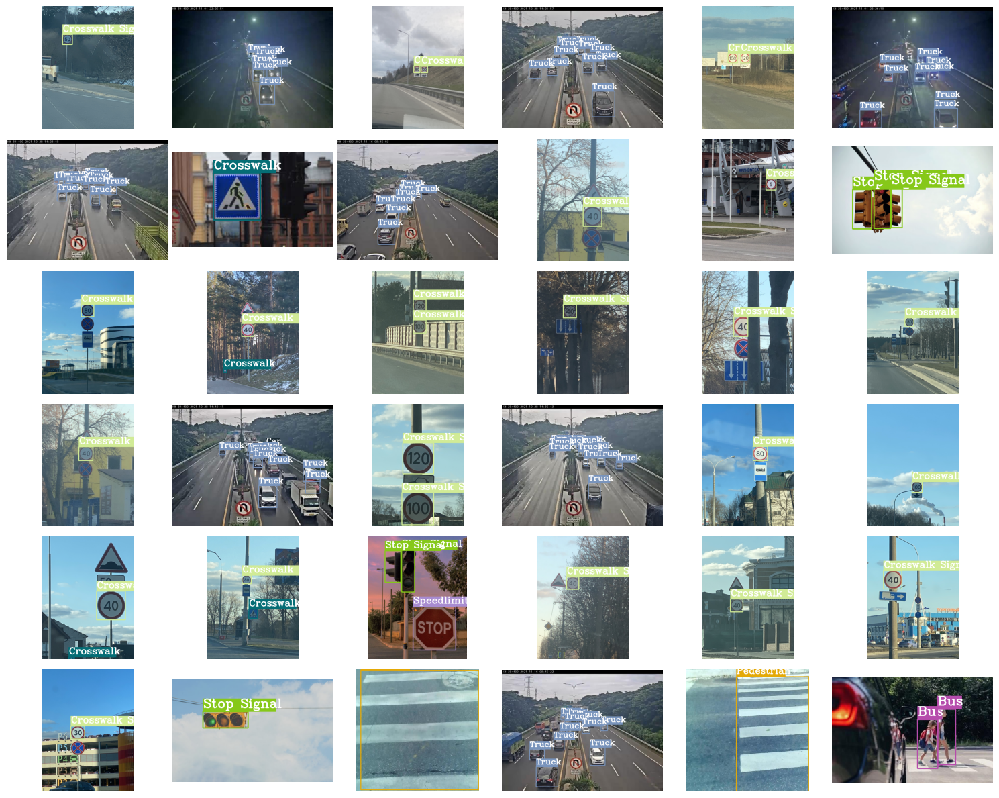

In [5]:
import glob
from IPython.display import Image, display
import cv2
import random
import os
import matplotlib.pyplot as plt
import numpy as np
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0] - bboxes[2] / 2, bboxes[1] - bboxes[3] / 2
    xmax, ymax = bboxes[0] + bboxes[2] / 2, bboxes[1] + bboxes[3] / 2
    return xmin, ymin, xmax, ymax

def plot_box(image, bboxes, labels):
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        xmin = int(x1 * w)
        ymin = int(y1 * h)
        xmax = int(x2 * w)
        ymax = int(y2 * h)

        label_index = int(labels[box_num])
        if label_index >= len(class_names):
            continue

        class_name = class_names[label_index]

        cv2.rectangle(
            image,
            (xmin, ymin), (xmax, ymax),
            color=colors[label_index],
            thickness=2
        )

        font_scale = min(1, max(3, int(w / 500)))
        font_thickness = min(2, max(10, int(w / 50)))

        tw, th = cv2.getTextSize(class_name, 0, fontScale=font_scale, thickness=font_thickness)[0]
        cv2.rectangle(
            image,
            (xmin, ymin - th - 10), (xmin + tw, ymin),
            color=colors[label_index],
            thickness=-1
        )

        cv2.putText(
            image,
            class_name,
            (xmin + 1, ymin - 10),
            cv2.FONT_HERSHEY_COMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()

    num_images = len(all_training_images)
    plt.figure(figsize=(15, 12))

    for i in range(num_samples):
        j = random.randint(0, num_images - 1)
        image = cv2.imread(all_training_images[j])
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                parts = label_line.strip().split(' ')
                label = int(parts[0])
                x_c, y_c, w, h = map(float, parts[1:])
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)

        result_image = plot_box(image, bboxes, labels)

        plt.subplot(6, 6, i + 1)
        plt.imshow(result_image)
        plt.axis('off')

    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

plot(image_paths=r'C:\Users\Windows\Desktop\selva postulate\Mine\road sign\train\images\*',
     label_paths=r'C:\Users\Windows\Desktop\selva postulate\Mine\road sign\train\labels\*',
     num_samples=36)


In [ ]:
model.train(
    data=r'C:\Users\Windows\Desktop\selva postulate\Mine\road sign\dataset.yaml',
    epochs=5,
    imgsz=480)

New https://pypi.org/project/ultralytics/8.3.67 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.55  Python-3.12.7 torch-2.5.1+cpu CPU (AMD PRO A4-4350B R4, 5 COMPUTE CORES 2C+3G)
engine\trainer: task=detect, mode=train, model=yolo11s.pt, data=C:\Users\Windows\Desktop\selva postulate\Mine\road sign\dataset.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=480, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=Non

train: Scanning C:\Users\Windows\Desktop\selva postulate\Mine\road sign\train\labels.cache... 1263 images, 5 backgrounds, 0 corrupt: 100%|██████████| 1263/1263 [00:00<?, ?it/s]
val: Scanning C:\Users\Windows\Desktop\selva postulate\Mine\road sign\val\labels.cache... 158 images, 0 backgrounds, 0 corrupt: 100%|██████████| 158/158 [00:00<?, ?it/s]


Plotting labels to runs\detect\train2\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added 
Image sizes 480 train, 480 val
Using 0 dataloader workers
Logging results to runs\detect\train2
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      1.477      5.165      1.162         67        480:   5%|▌         | 4/79 [39:57<13:37:18, 653.84s/it]

In [9]:
metrics = model.val(split='val')

print(f"Mean Average Precision @.5:.95 : {metrics.box.map}")
print(f"Mean Average Precision @ .50   : {metrics.box.map50}")
print(f"Mean Average Precision @ .70   : {metrics.box.map75}")
print("recall : ",metrics.box.r)
print(metrics.box.f1)
print(metrics.box.maps)

Ultralytics 8.3.55 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.20GHz)
YOLO11s summary (fused): 238 layers, 9,416,283 parameters, 0 gradients, 21.3 GFLOPs


val: Scanning /content/drive/MyDrive/road sign/dataset/val/labels.cache... 158 images, 0 backgrounds, 0 corrupt: 100%|██████████| 158/158 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:56<00:00,  5.66s/it]


                   all        158        794      0.891      0.771      0.845      0.622
   Trafic Light Signal          8         16          1      0.613      0.728      0.497
           Stop Signal          8          8      0.772          1      0.926      0.827
     Speedlimit Signal         67         71      0.991          1      0.995      0.879
      Crosswalk Signal         17         21      0.826      0.714      0.802      0.629
             Crosswalk         17         18      0.974      0.778      0.893      0.705
            Pedestrian         10         29      0.885      0.828      0.914      0.622
                   Bus          8          9      0.828      0.556      0.653      0.477
                   Car         45        407      0.883      0.684      0.824      0.447
                 Truck         43        215       0.86      0.771      0.866      0.514
Speed: 1.7ms preprocess, 324.2ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs/dete


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1042.jpg: 480x480 1 Crosswalk, 379.0ms
Speed: 2.8ms preprocess, 379.0ms inference, 7.2ms postprocess per image at shape (1, 3, 480, 480)


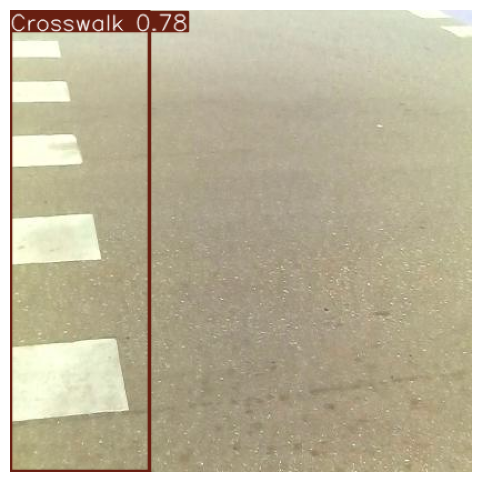


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1040.jpg: 480x480 1 Crosswalk, 606.8ms
Speed: 11.6ms preprocess, 606.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


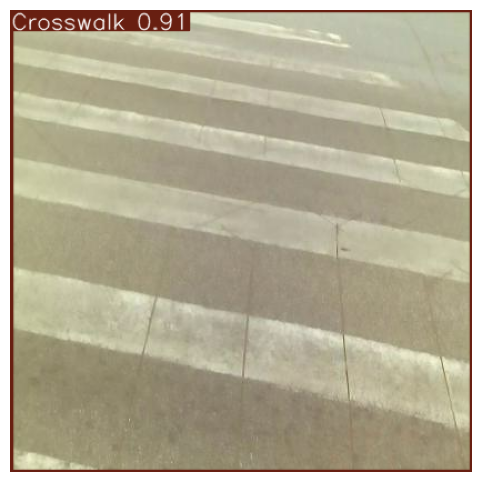


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1260.jpg: 320x480 14 Pedestrians, 410.7ms
Speed: 5.4ms preprocess, 410.7ms inference, 1.4ms postprocess per image at shape (1, 3, 320, 480)


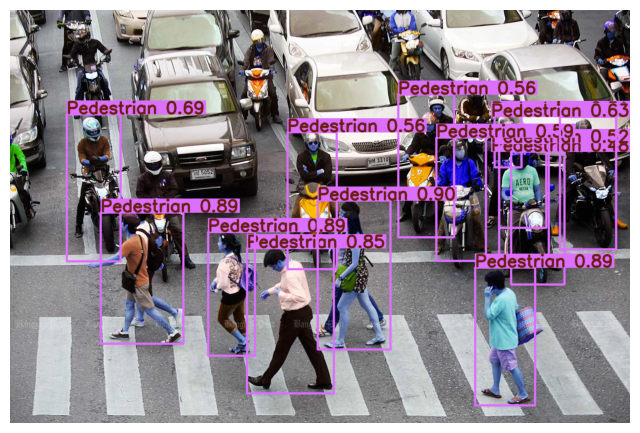


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1057.jpg: 480x480 3 Pedestrians, 502.9ms
Speed: 3.5ms preprocess, 502.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


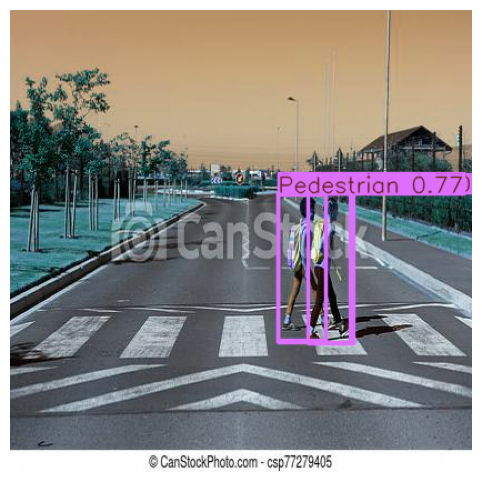


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1263.jpg: 320x480 5 Pedestrians, 448.3ms
Speed: 2.6ms preprocess, 448.3ms inference, 1.5ms postprocess per image at shape (1, 3, 320, 480)


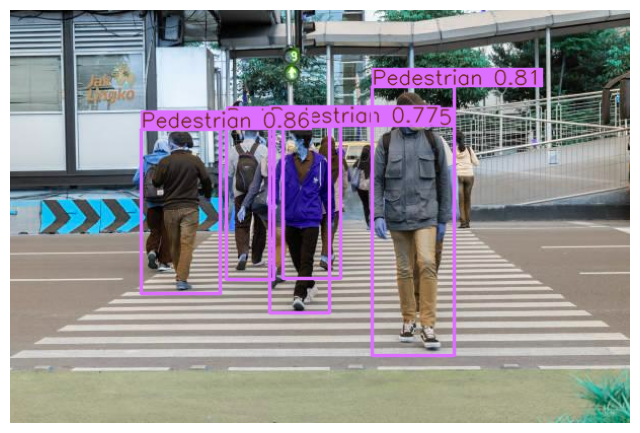


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1262.jpg: 320x480 3 Pedestrians, 395.8ms
Speed: 2.8ms preprocess, 395.8ms inference, 1.5ms postprocess per image at shape (1, 3, 320, 480)


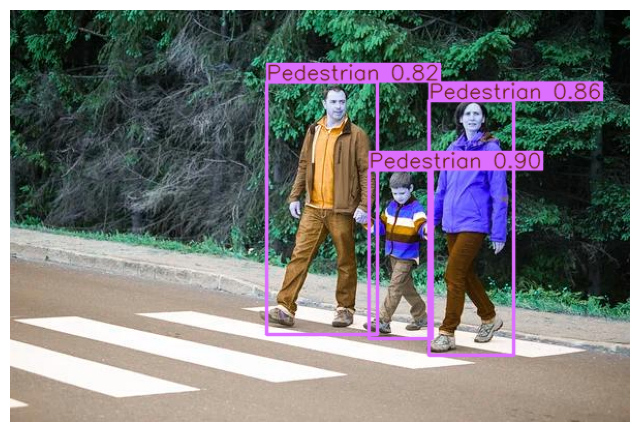


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1265.jpg: 320x480 2 Pedestrians, 415.3ms
Speed: 4.3ms preprocess, 415.3ms inference, 1.9ms postprocess per image at shape (1, 3, 320, 480)


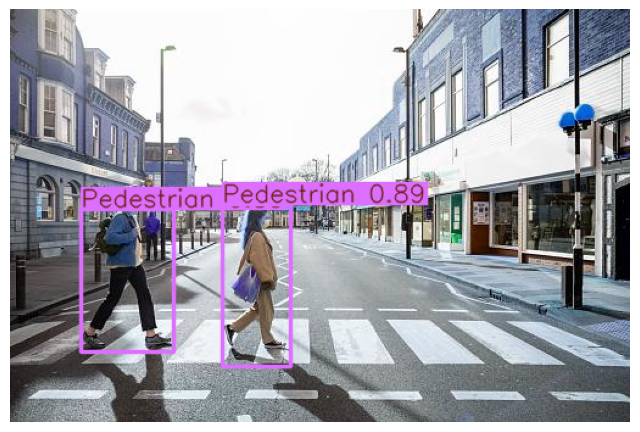


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1054.jpg: 480x480 1 Crosswalk, 475.8ms
Speed: 3.8ms preprocess, 475.8ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 480)


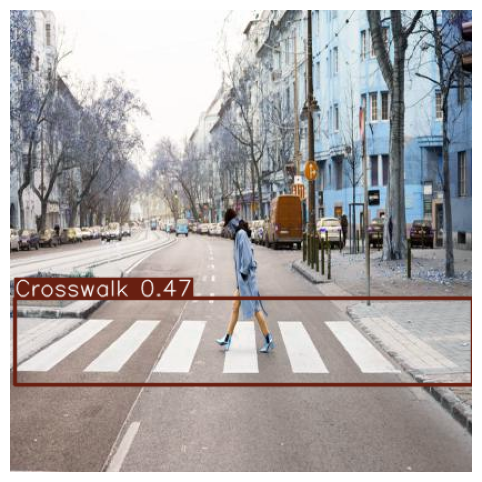


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1261.jpg: 320x480 18 Pedestrians, 328.4ms
Speed: 4.5ms preprocess, 328.4ms inference, 1.2ms postprocess per image at shape (1, 3, 320, 480)


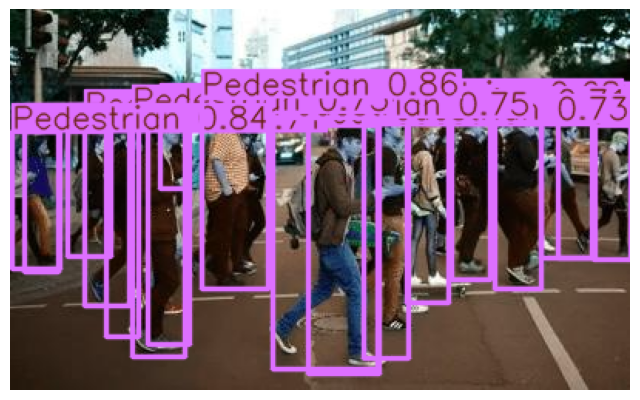


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1056.jpg: 480x480 1 Crosswalk, 435.5ms
Speed: 4.0ms preprocess, 435.5ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 480)


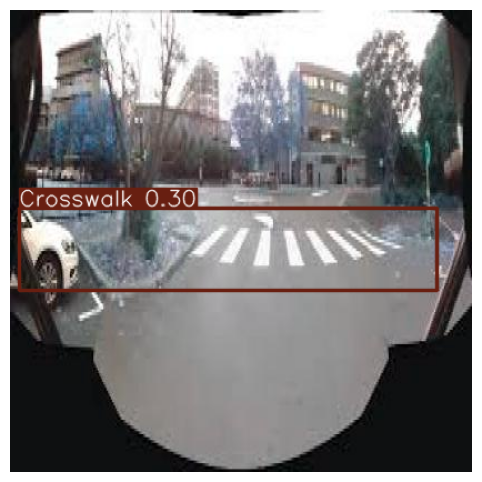


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1264.jpg: 384x480 5 Pedestrians, 358.3ms
Speed: 4.8ms preprocess, 358.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 480)


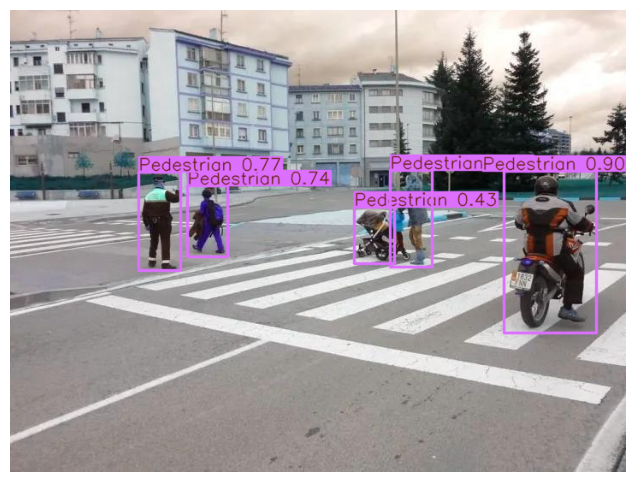


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1068.jpg: 480x480 1 Crosswalk, 461.6ms
Speed: 3.8ms preprocess, 461.6ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 480)


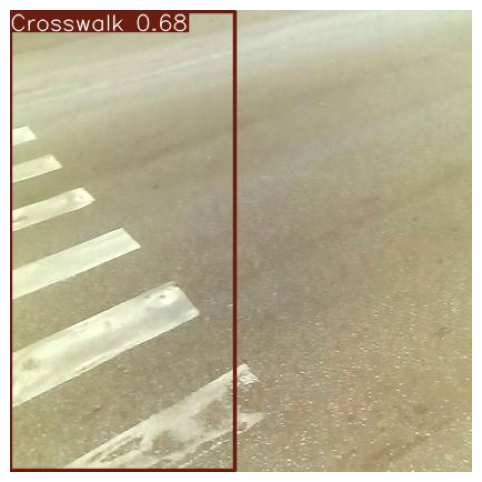


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1043.jpg: 480x480 1 Crosswalk, 409.2ms
Speed: 3.5ms preprocess, 409.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 480)


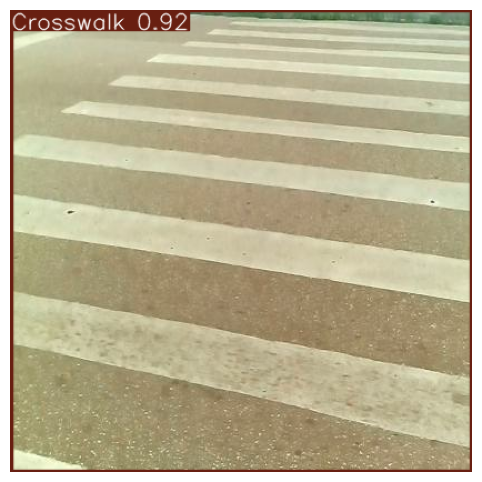


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1478.jpg: 384x480 10 Cars, 7 Trucks, 357.8ms
Speed: 3.2ms preprocess, 357.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 480)


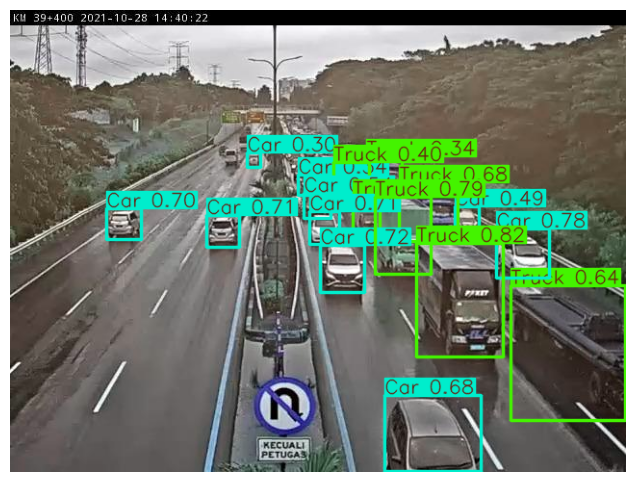


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1450.jpg: 384x480 3 Cars, 7 Trucks, 353.3ms
Speed: 3.1ms preprocess, 353.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 480)


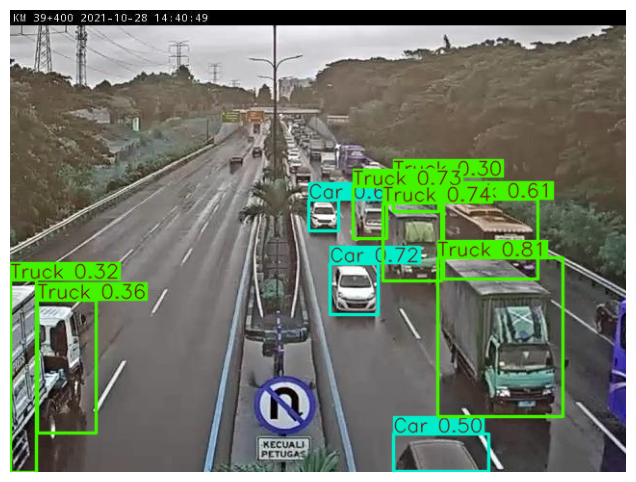


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1267.jpg: 320x480 3 Pedestrians, 326.2ms
Speed: 3.0ms preprocess, 326.2ms inference, 1.1ms postprocess per image at shape (1, 3, 320, 480)


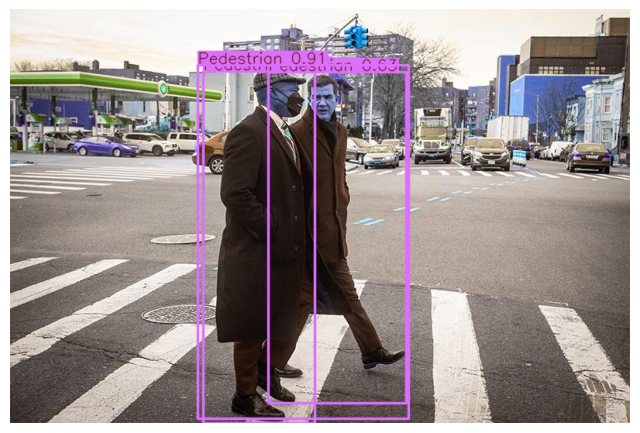


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1268.jpg: 320x480 4 Pedestrians, 365.6ms
Speed: 3.1ms preprocess, 365.6ms inference, 1.3ms postprocess per image at shape (1, 3, 320, 480)


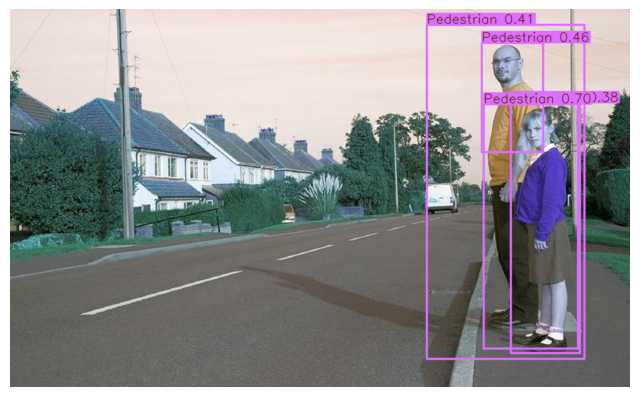


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1320.jpg: 384x480 3 Cars, 1 Truck, 370.7ms
Speed: 3.3ms preprocess, 370.7ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 480)


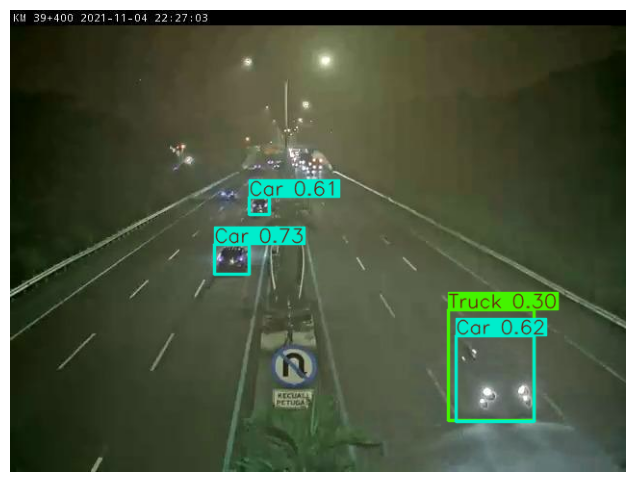


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1269.jpg: 320x480 1 Pedestrian, 331.0ms
Speed: 2.3ms preprocess, 331.0ms inference, 1.1ms postprocess per image at shape (1, 3, 320, 480)


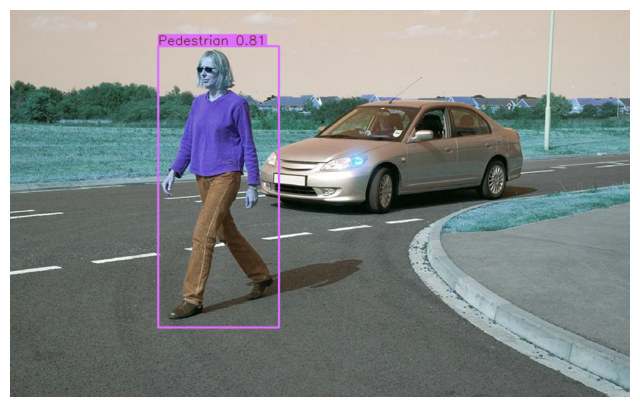


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1452.jpg: 384x480 10 Cars, 5 Trucks, 412.5ms
Speed: 3.3ms preprocess, 412.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 480)


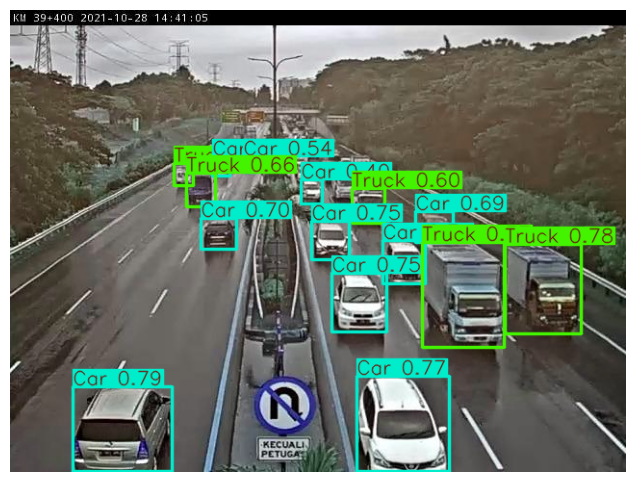


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1453.jpg: 384x480 9 Cars, 6 Trucks, 421.5ms
Speed: 3.3ms preprocess, 421.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 480)


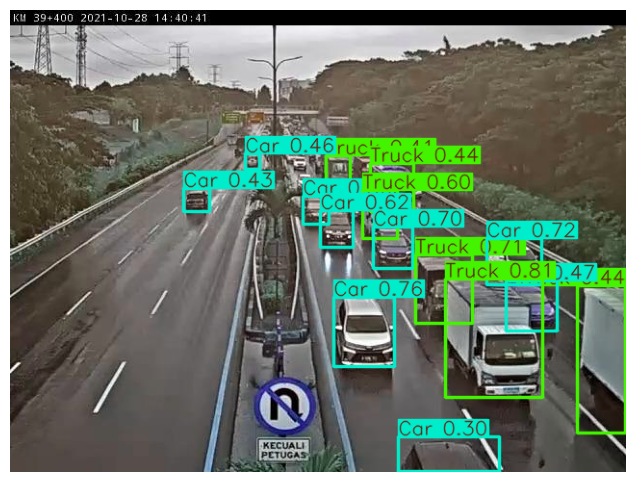


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1309.jpg: 384x480 5 Cars, 2 Trucks, 474.1ms
Speed: 3.4ms preprocess, 474.1ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 480)


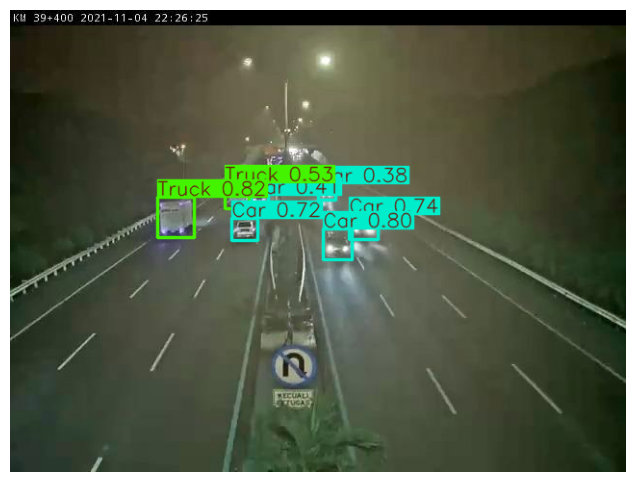


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1266.jpg: 320x480 3 Pedestrians, 409.5ms
Speed: 6.8ms preprocess, 409.5ms inference, 2.5ms postprocess per image at shape (1, 3, 320, 480)


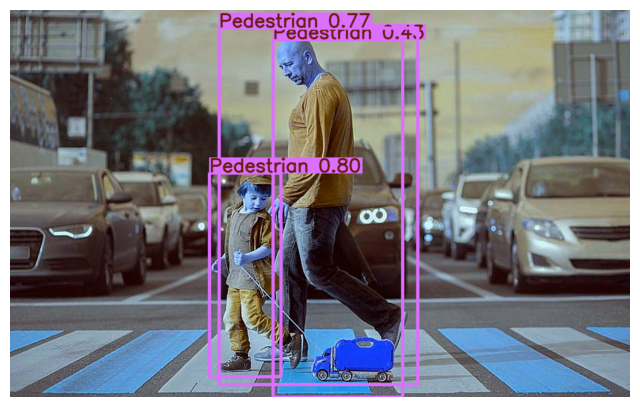


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1447.jpg: 384x480 6 Cars, 1 Truck, 453.4ms
Speed: 9.1ms preprocess, 453.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 480)


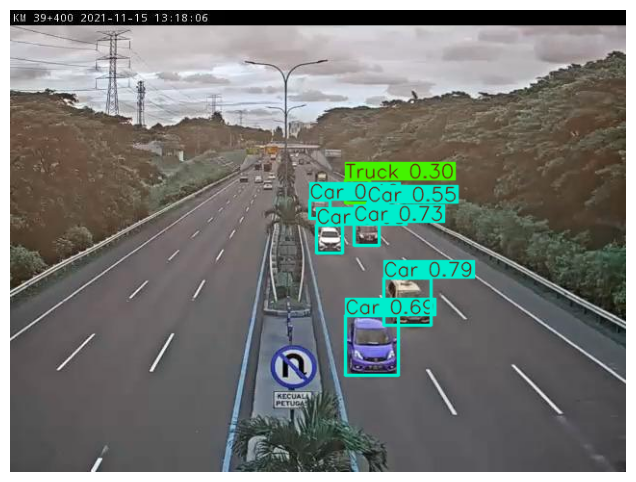


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1334.jpg: 384x480 1 Bus, 10 Cars, 10 Trucks, 507.6ms
Speed: 3.2ms preprocess, 507.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 480)


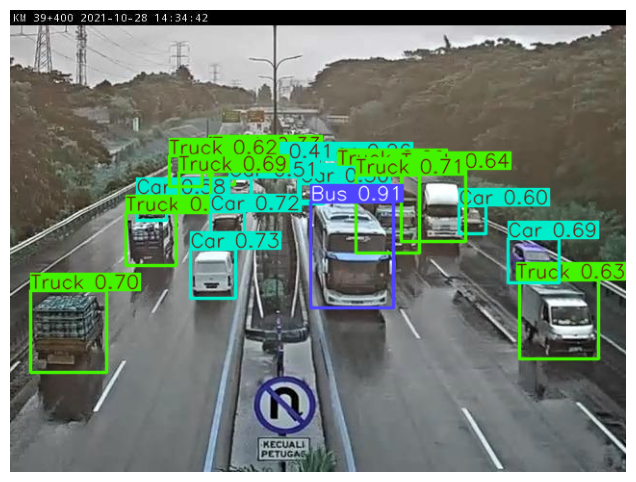


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1335.jpg: 384x480 9 Cars, 1 Truck, 429.8ms
Speed: 3.2ms preprocess, 429.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 480)


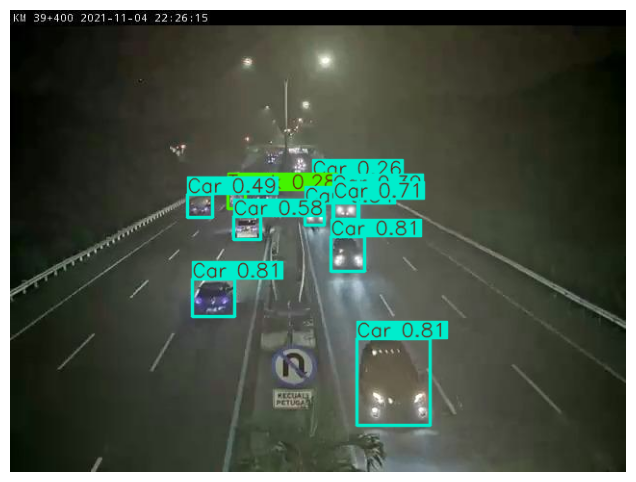


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1446.jpg: 384x480 9 Cars, 6 Trucks, 479.3ms
Speed: 3.0ms preprocess, 479.3ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 480)


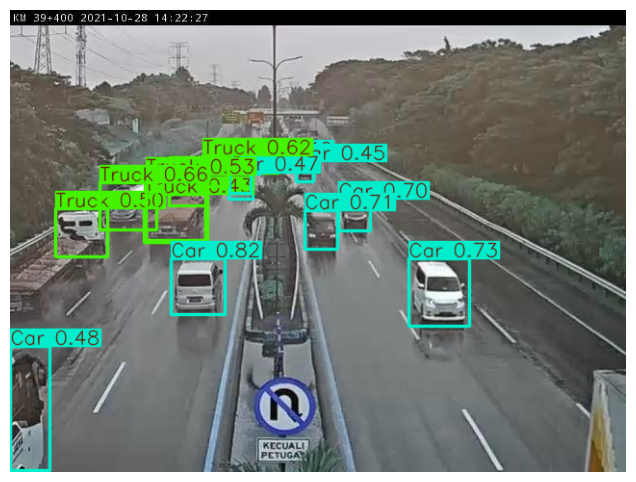


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1308.jpg: 384x480 12 Cars, 4 Trucks, 427.0ms
Speed: 3.2ms preprocess, 427.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 480)


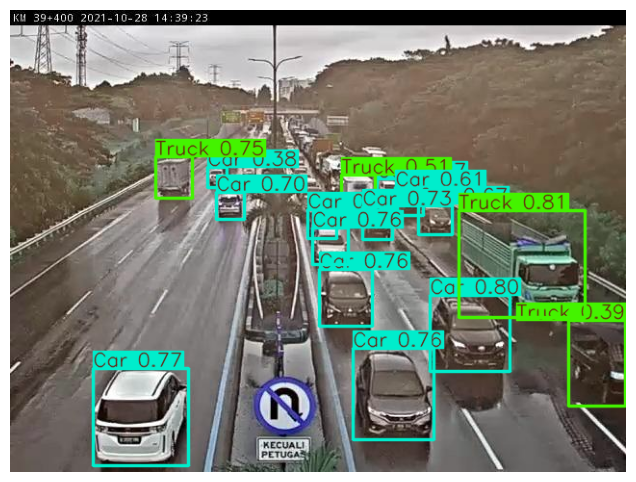


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1321.jpg: 384x480 6 Cars, 2 Trucks, 433.5ms
Speed: 8.5ms preprocess, 433.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 480)


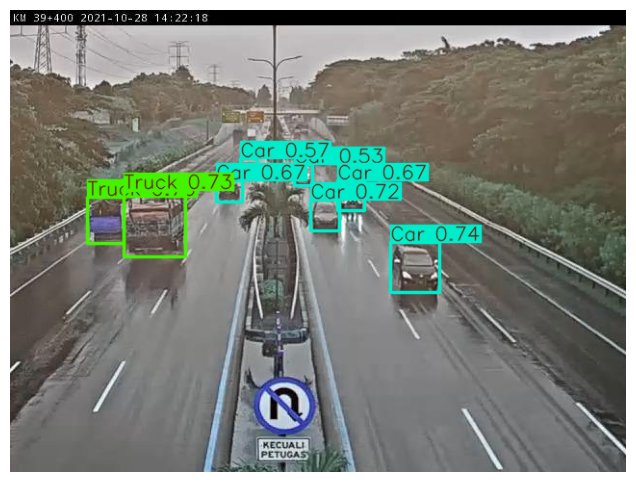


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i161.png: 480x384 1 Speedlimit Signal, 1347.2ms
Speed: 3.0ms preprocess, 1347.2ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 384)


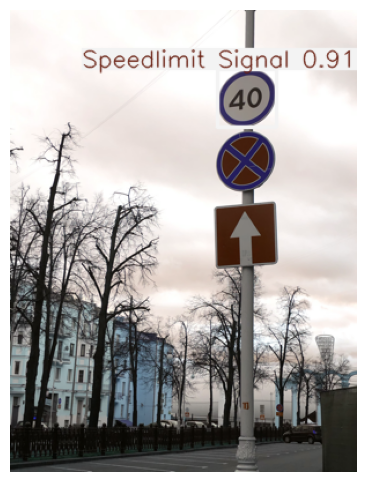


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1533.jpg: 384x480 9 Cars, 4 Trucks, 1200.0ms
Speed: 6.0ms preprocess, 1200.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 480)


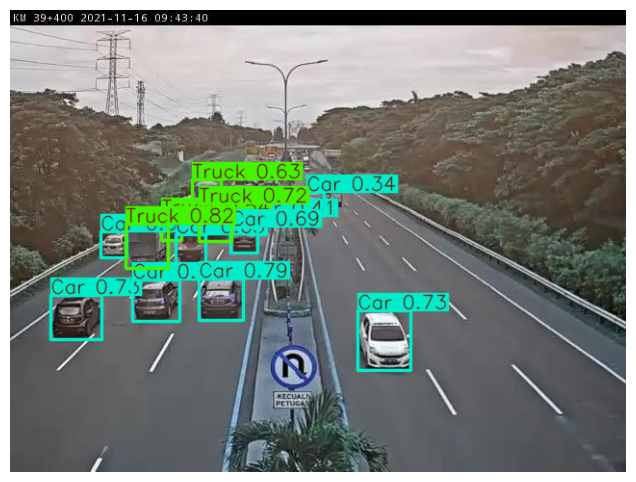


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1530.jpg: 384x480 4 Cars, 1 Truck, 414.7ms
Speed: 3.6ms preprocess, 414.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 480)


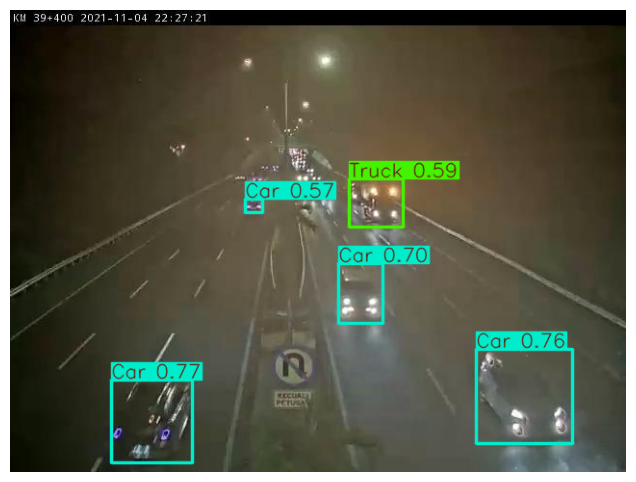


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1487.jpg: 384x480 10 Cars, 12 Trucks, 440.8ms
Speed: 3.7ms preprocess, 440.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 480)


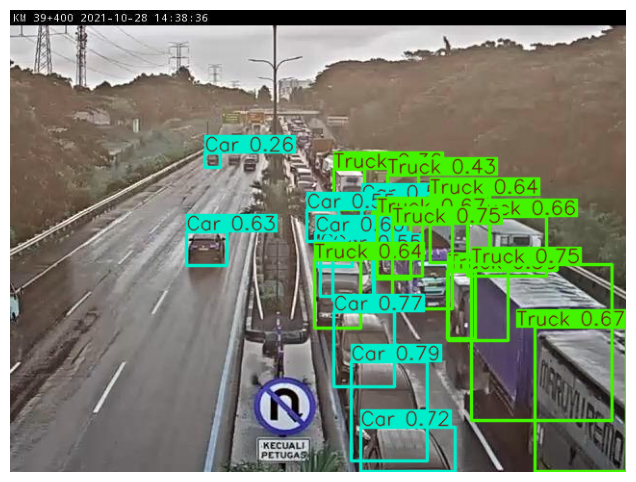


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1493.jpg: 384x480 7 Cars, 11 Trucks, 438.6ms
Speed: 5.4ms preprocess, 438.6ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 480)


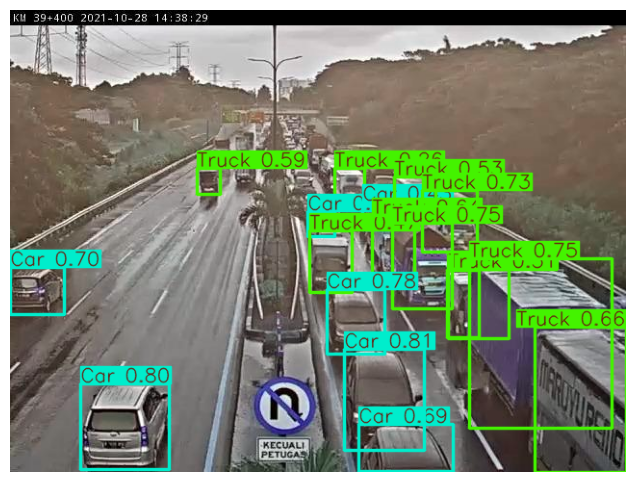


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1490.jpg: 384x480 13 Cars, 4 Trucks, 408.5ms
Speed: 3.3ms preprocess, 408.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 480)


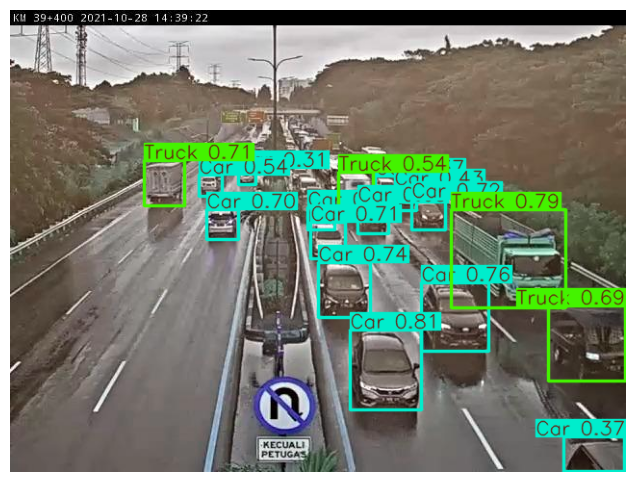


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1524.jpg: 384x480 11 Cars, 7 Trucks, 393.0ms
Speed: 3.7ms preprocess, 393.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 480)


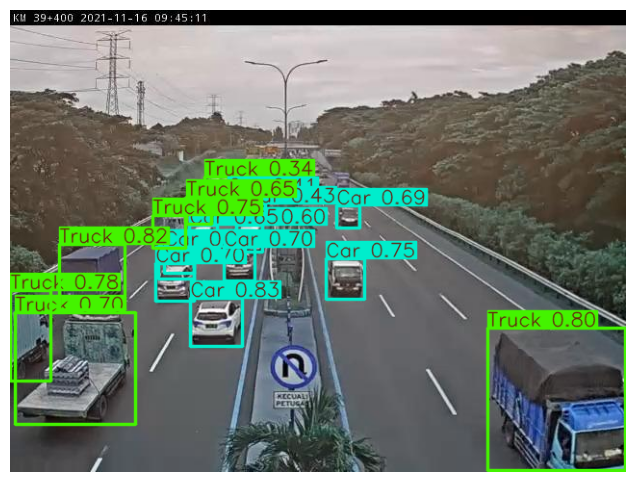


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i162.png: 480x384 1 Speedlimit Signal, 408.6ms
Speed: 5.0ms preprocess, 408.6ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 384)


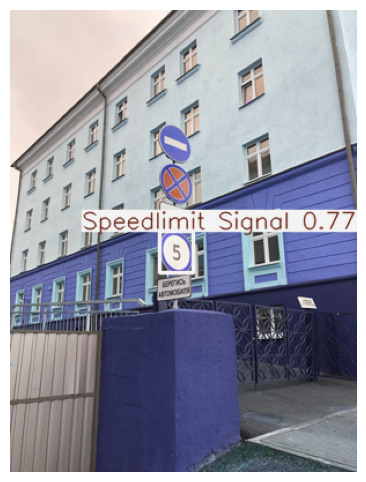


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1485.jpg: 384x480 11 Cars, 9 Trucks, 426.8ms
Speed: 6.5ms preprocess, 426.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 480)


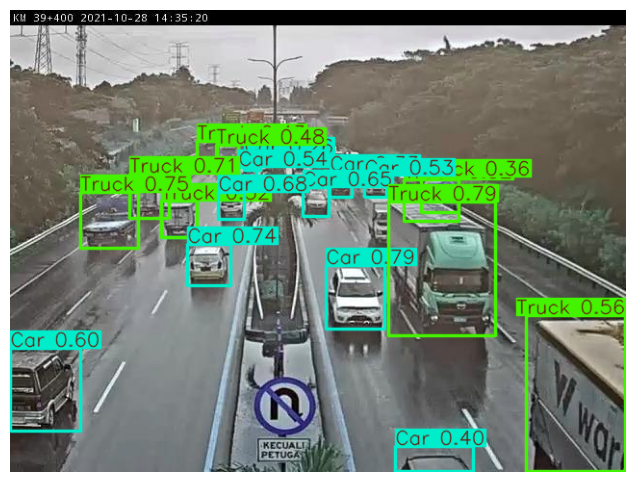


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i148.png: 384x480 1 Crosswalk Signal, 426.3ms
Speed: 3.0ms preprocess, 426.3ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 480)


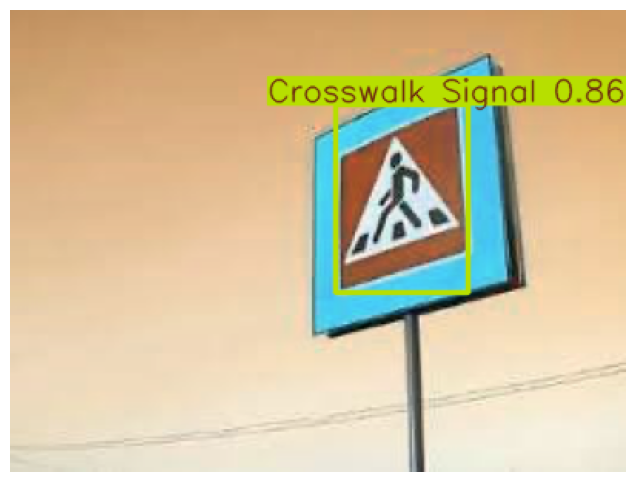


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1527.jpg: 384x480 10 Cars, 8 Trucks, 400.5ms
Speed: 3.2ms preprocess, 400.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 480)


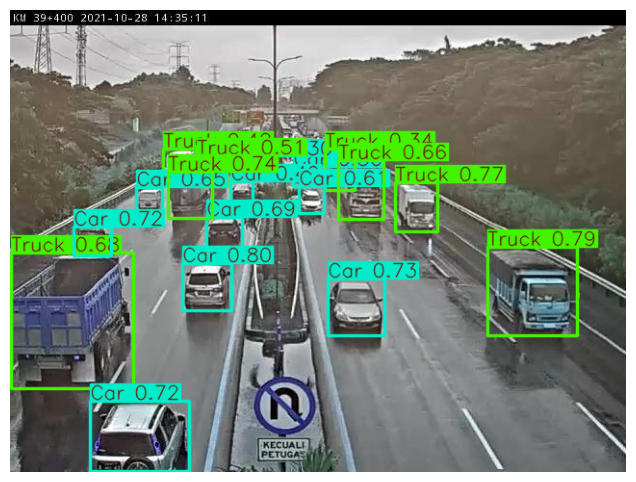


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1491.jpg: 384x480 15 Cars, 4 Trucks, 460.5ms
Speed: 3.2ms preprocess, 460.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 480)


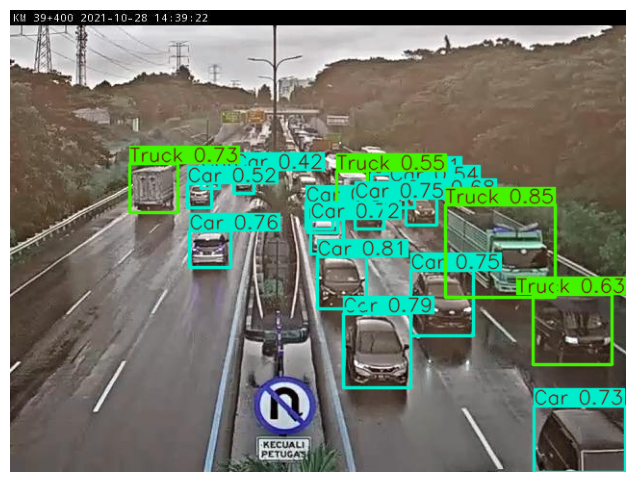


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1518.jpg: 384x480 6 Cars, 7 Trucks, 463.8ms
Speed: 3.5ms preprocess, 463.8ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 480)


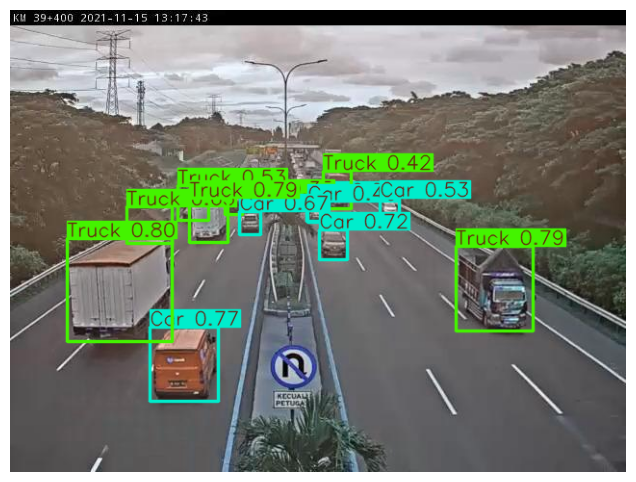


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i160.png: 480x384 1 Stop Signal, 2 Crosswalk Signals, 418.9ms
Speed: 2.8ms preprocess, 418.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 384)


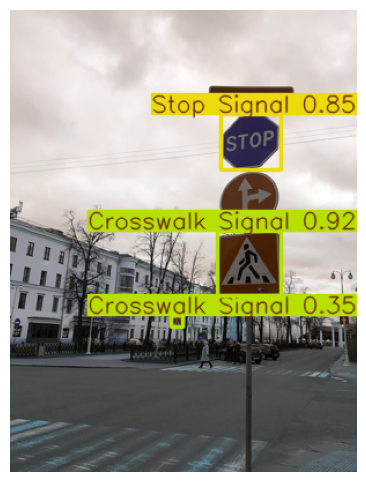


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i1526.jpg: 384x480 9 Cars, 6 Trucks, 449.3ms
Speed: 3.5ms preprocess, 449.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 480)


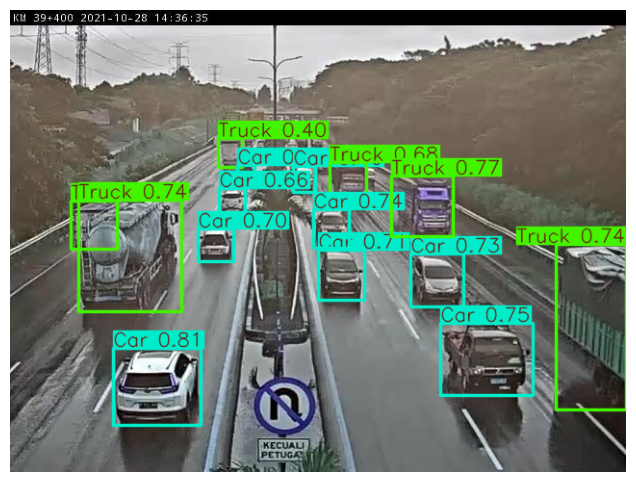


image 1/1 /content/drive/MyDrive/road sign/dataset/test/images/i149.png: 288x480 1 Crosswalk Signal, 354.2ms
Speed: 2.1ms preprocess, 354.2ms inference, 1.3ms postprocess per image at shape (1, 3, 288, 480)


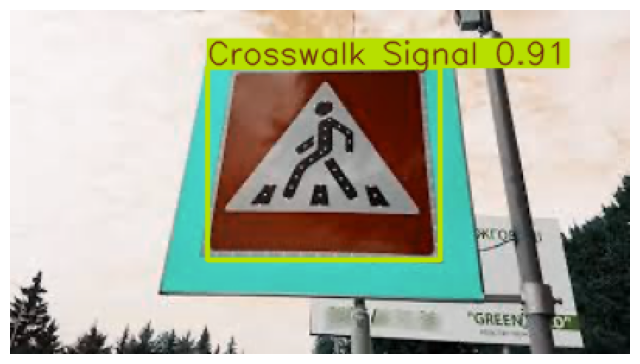

In [10]:
import random
import matplotlib.pyplot as plt
from ultralytics import YOLO
import cv2
import os

image_dir = r"C:\Users\Windows\Desktop\selva postulate\Mine\road sign\test\images"

all_images = os.listdir(image_dir)
selected_images = all_images[:45]

for img_name in selected_images:
    img_path = os.path.join(image_dir, img_name)
    results = model.predict(img_path)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    for result in results:
        plotted_img = result.plot()
        plt.figure(figsize=(8, 6))
        plt.imshow(plotted_img)
        plt.axis('off')
        plt.show()